# 🌾 Paddy Disease Classification: A CNN-based Approach using TensorFlow 🛢️🚀 🧠

## 🇵🇰 Dedicated to Pakistani Farmers & Agriculture Community
>"Pakistan mein chawal ki fasal hamare kisan bhaiyon ki rozi roti hai. Yeh project unki madad ke liye hai!"

>Rice is Pakistan's second-largest export crop, earning over $2 billion annually. This AI-powered solution aims to protect our farmers from devastating crop diseases!

# 📑 Table of Contents
1. Introduction & Problem Understanding
2. Environment Setup & Library Imports
3. Data Acquisition via Kaggle API
4. Comprehensive Exploratory Data Analysis (EDA)
5. Data Preprocessing & Augmentation Pipeline
6. CNN Model Architecture Development
7. Model Training & Optimization
8. Model Evaluation & Performance Analysis
9. Test Predictions & Kaggle Submission
10. Advanced Techniques for 99%+ Accuracy
11. Conclusion & Future Scope

<a id="section-1"></a>

# 🎯 1. Introduction & Problem Understanding
## 📖 Markdown Cell: Problem Statement
### 🌾 Background
Rice (Oryza sativa) is one of the most important staple foods worldwide, feeding over half of the global population. In Pakistan, rice cultivation spans across Punjab and Sindh provinces, contributing significantly to our economy and food security.

### ⚠️ The Challenge
Paddy crops face numerous threats from diseases and pests that can cause up to 70% yield loss. Traditional manual diagnosis by experts is:

- ❌ Time-consuming
- ❌ Expensive
- ❌ Limited in availability
- ❌ Prone to human error
### 💡 Our Solution
We will build a Convolutional Neural Network (CNN) using TensorFlow to automatically classify paddy leaf images into 10 categories:

- 9 Disease Classes
- 1 Normal/Healthy Class
### 🏆 Competition Goal
Achieve classification accuracy above 0.99461 to win the competition!

In [1]:
# ╔══════════════════════════════════════════════════════════════════════════════╗
# ║                    PADDY DISEASE CLASSIFICATION PROJECT                       ║
# ║                    CNN-Based Approach using TensorFlow                        ║
# ║                                                                               ║
# ║  Author: Hammad Zahid                                                         ║
# ║  LinkedIn: www.linkedin.com/in/hammad-zahid-xyz                              ║
# ║  GitHub: https://github.com/Hamad-Ansari                                     ║
# ║  Email: Hammadzahid24@gmail.com                                              ║
# ║                                                                               ║
# ║  🎯 Goal: Win competition with accuracy > 0.99461                            ║
# ╚══════════════════════════════════════════════════════════════════════════════╝

print("🌾 Paddy Disease Classification Project")
print("=" * 60)
print("🎯 Target: Achieve >99.461% Accuracy")
print("📊 Dataset: 10,407 training + 3,469 test images")
print("🏷️  Classes: 10 (9 diseases + 1 normal)")
print("=" * 60)

🌾 Paddy Disease Classification Project
🎯 Target: Achieve >99.461% Accuracy
📊 Dataset: 10,407 training + 3,469 test images
🏷️  Classes: 10 (9 diseases + 1 normal)


<a id="section-2"></a>

# 🔧 2. Environment Setup & Library Imports
## 📖 Markdown Cell: Setting Up Our Arsenal
Before diving into the deep learning ocean, we need to set up our development environment with all necessary libraries. We'll use:

| Library            | Purpose                          |
|--------------------|----------------------------------|
| TensorFlow / Keras | Deep Learning Framework           |
| NumPy              | Numerical Computing               |
| Pandas             | Data Manipulation                 |
| Matplotlib / Seaborn | Static Visualizations            |
| Plotly             | Interactive Visualizations        |
| OpenCV             | Image Processing                  |
| Scikit-learn       | ML Utilities & Metrics            |



In [ ]:
# ══════════════════════════════════════════════════════════════════════════════
# 📦 SECTION 2.1: INSTALL REQUIRED PACKAGES
# ══════════════════════════════════════════════════════════════════════════════

# Install packages (run this cell only once)
!pip install -q tensorflow==2.15.0
!pip install -q tensorflow-addons
!pip install -q opencv-python-headless
!pip install -q plotly
!pip install -q seaborn
!pip install -q kaggle
!pip install -q albumentations
!pip install -q tqdm

print("✅ All packages installed successfully!")

In [2]:
# ══════════════════════════════════════════════════════════════════════════════
# 📦 SECTION 2.2: IMPORT ALL LIBRARIES
# ══════════════════════════════════════════════════════════════════════════════

# ─────────────────────────────────────────────────────────────────────────────
# Core Python Libraries
# ─────────────────────────────────────────────────────────────────────────────
import os                          # Operating system interface
import sys                         # System-specific parameters
import warnings                    # Warning control
import random                      # Random number generation
import gc                          # Garbage collection
from glob import glob              # File path pattern matching
from pathlib import Path           # Object-oriented filesystem paths
from collections import Counter    # Count hashable objects

# Suppress warnings for cleaner output
warnings.filterwarnings('ignore')
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'

# ─────────────────────────────────────────────────────────────────────────────
# Data Manipulation Libraries
# ─────────────────────────────────────────────────────────────────────────────
import numpy as np                 # Numerical computing
import pandas as pd                # Data manipulation and analysis

# ─────────────────────────────────────────────────────────────────────────────
# Visualization Libraries
# ─────────────────────────────────────────────────────────────────────────────
import matplotlib.pyplot as plt    # Static plotting
import matplotlib.patches as mpatches
import matplotlib.animation as animation
from matplotlib.colors import LinearSegmentedColormap
import seaborn as sns              # Statistical visualizations
import plotly.express as px        # Interactive plots
import plotly.graph_objects as go  # Advanced Plotly plots
from plotly.subplots import make_subplots

# Set visualization styles
plt.style.use('seaborn-v0_8-whitegrid')
plt.rcParams['figure.figsize'] = (14, 8)
plt.rcParams['font.size'] = 12
plt.rcParams['axes.titlesize'] = 16
plt.rcParams['axes.labelsize'] = 14
sns.set_palette("husl")

# ─────────────────────────────────────────────────────────────────────────────
# Image Processing Libraries
# ─────────────────────────────────────────────────────────────────────────────
import cv2                         # OpenCV for image processing
from PIL import Image              # Python Imaging Library

# ─────────────────────────────────────────────────────────────────────────────
# TensorFlow & Keras Libraries
# ─────────────────────────────────────────────────────────────────────────────
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers, models, optimizers, callbacks
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import (
    EfficientNetV2B3,
    EfficientNetV2S,
    EfficientNetV2M,
    ResNet152V2,
    InceptionV3,
    Xception,
    DenseNet201
)
from tensorflow.keras.layers import (
    Input, Dense, Dropout, Flatten, 
    GlobalAveragePooling2D, GlobalMaxPooling2D,
    BatchNormalization, Conv2D, MaxPooling2D,
    Concatenate, Add, Activation
)
from tensorflow.keras.models import Model, Sequential, load_model
from tensorflow.keras.callbacks import (
    EarlyStopping, ModelCheckpoint, 
    ReduceLROnPlateau, TensorBoard,
    LearningRateScheduler
)
from tensorflow.keras.optimizers import Adam, SGD, RMSprop
from tensorflow.keras.losses import CategoricalCrossentropy
from tensorflow.keras.metrics import CategoricalAccuracy
from tensorflow.keras.regularizers import l2

# ─────────────────────────────────────────────────────────────────────────────
# Scikit-learn Libraries
# ─────────────────────────────────────────────────────────────────────────────
from sklearn.model_selection import train_test_split, StratifiedKFold
from sklearn.metrics import (
    confusion_matrix, classification_report,
    accuracy_score, precision_score, recall_score, f1_score,
    roc_curve, auc, precision_recall_curve
)
from sklearn.preprocessing import LabelEncoder

# ─────────────────────────────────────────────────────────────────────────────
# Progress Bar
# ─────────────────────────────────────────────────────────────────────────────
from tqdm.notebook import tqdm

# ─────────────────────────────────────────────────────────────────────────────
# Set Random Seeds for Reproducibility
# ─────────────────────────────────────────────────────────────────────────────
SEED = 42

def set_seed(seed=SEED):
    """Set random seeds for reproducibility across all libraries."""
    random.seed(seed)
    np.random.seed(seed)
    tf.random.set_seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    os.environ['TF_DETERMINISTIC_OPS'] = '1'
    
set_seed(SEED)

print("🎉 All libraries imported successfully!")
print("=" * 60)

🎉 All libraries imported successfully!


In [3]:
# ══════════════════════════════════════════════════════════════════════════════
# 📦 SECTION 2.3: CHECK SYSTEM CONFIGURATION
# ══════════════════════════════════════════════════════════════════════════════

print("🖥️  SYSTEM CONFIGURATION")
print("=" * 60)

# Python version
print(f"📌 Python Version: {sys.version.split()[0]}")

# TensorFlow version
print(f"📌 TensorFlow Version: {tf.__version__}")

# Check GPU availability
gpus = tf.config.list_physical_devices('GPU')
if gpus:
    print(f"🚀 GPU Available: {len(gpus)} GPU(s) detected!")
    for gpu in gpus:
        print(f"   └── {gpu.name}")
    # Enable memory growth to prevent GPU memory allocation issues
    for gpu in gpus:
        tf.config.experimental.set_memory_growth(gpu, True)
else:
    print("⚠️  No GPU detected. Training will be slower on CPU.")

# NumPy version
print(f"📌 NumPy Version: {np.__version__}")

# Pandas version
print(f"📌 Pandas Version: {pd.__version__}")

# OpenCV version
print(f"📌 OpenCV Version: {cv2.__version__}")

print("=" * 60)
print("✅ System configuration check complete!")

🖥️  SYSTEM CONFIGURATION
📌 Python Version: 3.13.7
📌 TensorFlow Version: 2.20.0
⚠️  No GPU detected. Training will be slower on CPU.
📌 NumPy Version: 2.2.6
📌 Pandas Version: 2.3.2
📌 OpenCV Version: 4.11.0
✅ System configuration check complete!


<a id="section-3"></a>

# 📥 3. Data Acquisition via Kaggle API
## 📖 Markdown Cell: Downloading the Dataset
We'll use the official Kaggle API to download the competition dataset. This ensures we have the exact same data as other competitors.

### 📁 Dataset Structure:
```
paddy-disease-classification/
├── train.csv                    # Training metadata
├── sample_submission.csv        # Submission format
├── train_images/               # 10,407 training images
│   ├── bacterial_leaf_blight/
│   ├── bacterial_leaf_streak/
│   ├── bacterial_panicle_blight/
│   ├── blast/
│   ├── brown_spot/
│   ├── dead_heart/
│   ├── downy_mildew/
│   ├── hispa/
│   ├── normal/
│   └── tungro/
└── test_images/                # 3,469 test images
```

In [4]:
# ══════════════════════════════════════════════════════════════════════════════
# 📥 SECTION 3.2: DOWNLOAD COMPETITION DATA
# ══════════════════════════════════════════════════════════════════════════════

# Download the competition dataset
print("📥 Downloading Paddy Disease Classification dataset...")
print("=" * 60)

!kaggle competitions download -c paddy-disease-classification

print("\n✅ Download complete!")

📥 Downloading Paddy Disease Classification dataset...
Could not find kaggle.json. Make sure it's located in C:\Users\Hammad\.kaggle. Or use the environment method. See setup instructions at https://github.com/Kaggle/kaggle-api/

✅ Download complete!


In [5]:
# ══════════════════════════════════════════════════════════════════════════════
# 📥 SECTION 3.3: EXTRACT AND ORGANIZE DATA
# ══════════════════════════════════════════════════════════════════════════════

import zipfile

# Define data directory
DATA_DIR = 'paddy_data'

# Create directory if it doesn't exist
os.makedirs(DATA_DIR, exist_ok=True)

# Extract the downloaded zip file
print("📦 Extracting dataset...")
with zipfile.ZipFile('paddy-disease-classification.zip', 'r') as zip_ref:
    zip_ref.extractall(DATA_DIR)

print("✅ Extraction complete!")

# List the contents
print("\n📂 Dataset contents:")
for item in os.listdir(DATA_DIR):
    item_path = os.path.join(DATA_DIR, item)
    if os.path.isdir(item_path):
        num_files = len(os.listdir(item_path))
        print(f"   📁 {item}/ ({num_files} items)")
    else:
        size = os.path.getsize(item_path) / 1024  # Size in KB
        print(f"   📄 {item} ({size:.2f} KB)")

📦 Extracting dataset...
✅ Extraction complete!

📂 Dataset contents:
   📄 sample_submission.csv (44.06 KB)
   📁 test_images/ (3469 items)
   📄 train.csv (327.37 KB)
   📁 train_images/ (10 items)


In [6]:
# ══════════════════════════════════════════════════════════════════════════════
# 📥 SECTION 3.4: DEFINE DATA PATHS
# ══════════════════════════════════════════════════════════════════════════════

# Define all important paths
TRAIN_CSV_PATH = os.path.join(DATA_DIR, 'train.csv')
SAMPLE_SUB_PATH = os.path.join(DATA_DIR, 'sample_submission.csv')
TRAIN_IMAGES_DIR = os.path.join(DATA_DIR, 'train_images')
TEST_IMAGES_DIR = os.path.join(DATA_DIR, 'test_images')

# Verify paths exist
paths_to_check = {
    'Training CSV': TRAIN_CSV_PATH,
    'Sample Submission': SAMPLE_SUB_PATH,
    'Training Images': TRAIN_IMAGES_DIR,
    'Test Images': TEST_IMAGES_DIR
}

print("🔍 Verifying data paths:")
print("=" * 60)
for name, path in paths_to_check.items():
    exists = "✅" if os.path.exists(path) else "❌"
    print(f"   {exists} {name}: {path}")

# Count images in each directory
train_count = sum([len(files) for _, _, files in os.walk(TRAIN_IMAGES_DIR)])
test_count = len(os.listdir(TEST_IMAGES_DIR))

print("\n📊 Image Counts:")
print(f"   🏋️ Training Images: {train_count:,}")
print(f"   🧪 Test Images: {test_count:,}")
print("=" * 60)

🔍 Verifying data paths:
   ✅ Training CSV: paddy_data\train.csv
   ✅ Sample Submission: paddy_data\sample_submission.csv
   ✅ Training Images: paddy_data\train_images
   ✅ Test Images: paddy_data\test_images

📊 Image Counts:
   🏋️ Training Images: 10,407
   🧪 Test Images: 3,469


<a id="section-4"></a>

# 📊 4. Comprehensive Exploratory Data Analysis (EDA)
## 📖 Markdown Cell: Understanding Our Data
EDA is the foundation of any successful ML project. We'll explore:

1. 📋 Training metadata analysis
2. 📊 Class distribution visualization
3. 🖼️ Image samples from each class
4. 📈 Statistical analysis of image properties
5. 🔗 Relationship between features
>"Data ko samajhna bahut zaroori hai - jitna achha data samjhoge, utna achha model banayoge!"
>(Understanding data is crucial - the better you understand data, the better your model!)

In [7]:
# ══════════════════════════════════════════════════════════════════════════════
# 📊 SECTION 4.1: LOAD AND INSPECT METADATA
# ══════════════════════════════════════════════════════════════════════════════

# Load training metadata
train_df = pd.read_csv(TRAIN_CSV_PATH)
sample_submission = pd.read_csv(SAMPLE_SUB_PATH)

print("📋 TRAINING DATA OVERVIEW")
print("=" * 70)
print(f"\n📐 Dataset Shape: {train_df.shape[0]:,} rows × {train_df.shape[1]} columns")
print(f"\n📌 Column Names: {list(train_df.columns)}")

# Display first few rows
print("\n🔍 First 10 Rows of Training Data:")
display(train_df.head(10))

# Display last few rows
print("\n🔍 Last 5 Rows of Training Data:")
display(train_df.tail(5))

📋 TRAINING DATA OVERVIEW

📐 Dataset Shape: 10,407 rows × 4 columns

📌 Column Names: ['image_id', 'label', 'variety', 'age']

🔍 First 10 Rows of Training Data:


,image_id,label,variety,age
0,100330.jpg,bacterial_leaf_blight,ADT45,45
1,100365.jpg,bacterial_leaf_blight,ADT45,45
2,100382.jpg,bacterial_leaf_blight,ADT45,45
3,100632.jpg,bacterial_leaf_blight,ADT45,45
4,101918.jpg,bacterial_leaf_blight,ADT45,45
5,102353.jpg,bacterial_leaf_blight,ADT45,45
6,102848.jpg,bacterial_leaf_blight,ADT45,45
7,103051.jpg,bacterial_leaf_blight,ADT45,45
8,103702.jpg,bacterial_leaf_blight,ADT45,45
9,103920.jpg,bacterial_leaf_blight,ADT45,45



🔍 Last 5 Rows of Training Data:


,image_id,label,variety,age
10402,107607.jpg,tungro,Zonal,55
10403,107811.jpg,tungro,Zonal,55
10404,108547.jpg,tungro,Zonal,55
10405,110245.jpg,tungro,Zonal,55
10406,110381.jpg,tungro,Zonal,55


In [8]:
# ══════════════════════════════════════════════════════════════════════════════
# 📊 SECTION 4.2: DATA TYPES AND BASIC STATISTICS
# ══════════════════════════════════════════════════════════════════════════════

print("📊 DATA TYPES AND INFO")
print("=" * 70)

# Data types
print("\n📌 Column Data Types:")
for col in train_df.columns:
    dtype = train_df[col].dtype
    unique_count = train_df[col].nunique()
    print(f"   • {col}: {dtype} ({unique_count:,} unique values)")

# Check for missing values
print("\n🔍 Missing Values Check:")
missing = train_df.isnull().sum()
for col, count in missing.items():
    status = "✅ No missing values" if count == 0 else f"⚠️ {count} missing values"
    print(f"   • {col}: {status}")

# Statistical summary for numerical columns
print("\n📈 Statistical Summary for 'age' column:")
display(train_df['age'].describe().to_frame().T)

📊 DATA TYPES AND INFO

📌 Column Data Types:
   • image_id: object (10,407 unique values)
   • label: object (10 unique values)
   • variety: object (10 unique values)
   • age: int64 (18 unique values)

🔍 Missing Values Check:
   • image_id: ✅ No missing values
   • label: ✅ No missing values
   • variety: ✅ No missing values
   • age: ✅ No missing values

📈 Statistical Summary for 'age' column:


,count,mean,std,min,25%,50%,75%,max
age,10407.0,64.043624,8.95883,45.0,60.0,67.0,70.0,82.0


In [9]:
# ══════════════════════════════════════════════════════════════════════════════
# 📊 SECTION 4.3: CLASS DISTRIBUTION ANALYSIS
# ══════════════════════════════════════════════════════════════════════════════

# Get class distribution
class_distribution = train_df['label'].value_counts().sort_index()
class_names = sorted(train_df['label'].unique())
num_classes = len(class_names)

print("🏷️ CLASS DISTRIBUTION")
print("=" * 70)
print(f"\n📌 Total Classes: {num_classes}")
print("\n📊 Samples per Class:")
for cls, count in class_distribution.items():
    percentage = (count / len(train_df)) * 100
    bar = "█" * int(percentage * 2)
    print(f"   {cls:30s}: {count:5,} ({percentage:5.2f}%) {bar}")

# Calculate class imbalance ratio
max_class = class_distribution.max()
min_class = class_distribution.min()
imbalance_ratio = max_class / min_class

print(f"\n⚖️ Class Imbalance Ratio: {imbalance_ratio:.2f}:1")
if imbalance_ratio > 2:
    print("   ⚠️ Moderate imbalance detected - consider using class weights or oversampling")
else:
    print("   ✅ Dataset is relatively balanced")

🏷️ CLASS DISTRIBUTION

📌 Total Classes: 10

📊 Samples per Class:
   bacterial_leaf_blight         :   479 ( 4.60%) █████████
   bacterial_leaf_streak         :   380 ( 3.65%) ███████
   bacterial_panicle_blight      :   337 ( 3.24%) ██████
   blast                         : 1,738 (16.70%) █████████████████████████████████
   brown_spot                    :   965 ( 9.27%) ██████████████████
   dead_heart                    : 1,442 (13.86%) ███████████████████████████
   downy_mildew                  :   620 ( 5.96%) ███████████
   hispa                         : 1,594 (15.32%) ██████████████████████████████
   normal                        : 1,764 (16.95%) █████████████████████████████████
   tungro                        : 1,088 (10.45%) ████████████████████

⚖️ Class Imbalance Ratio: 5.23:1
   ⚠️ Moderate imbalance detected - consider using class weights or oversampling


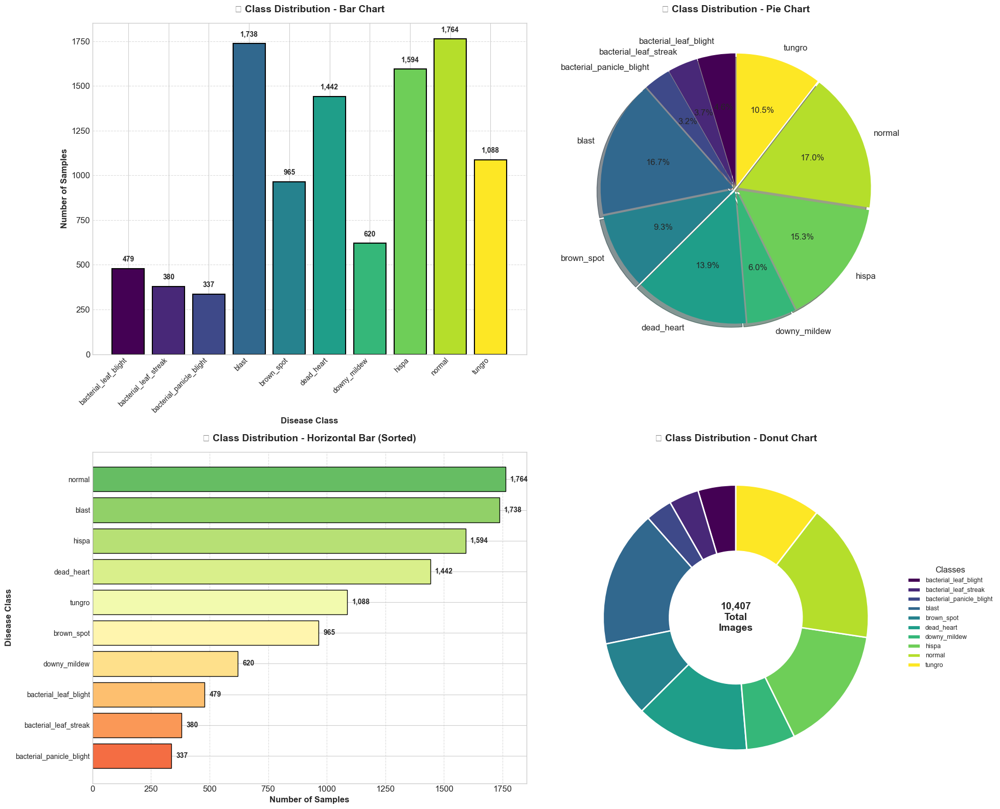


💾 Plot saved as 'class_distribution_plots.png'


In [10]:
# ══════════════════════════════════════════════════════════════════════════════
# 📊 SECTION 4.4: VISUALIZATION - CLASS DISTRIBUTION (MULTIPLE PLOT TYPES)
# ══════════════════════════════════════════════════════════════════════════════

# Create a comprehensive figure with multiple subplots
fig = plt.figure(figsize=(20, 16))

# ─────────────────────────────────────────────────────────────────────────────
# Plot 1: Bar Chart with Values
# ─────────────────────────────────────────────────────────────────────────────
ax1 = fig.add_subplot(2, 2, 1)
colors = plt.cm.viridis(np.linspace(0, 1, num_classes))
bars = ax1.bar(range(num_classes), class_distribution.values, color=colors, edgecolor='black', linewidth=1.5)

# Add value labels on bars
for bar, val in zip(bars, class_distribution.values):
    ax1.text(bar.get_x() + bar.get_width()/2, bar.get_height() + 30, 
             f'{val:,}', ha='center', va='bottom', fontsize=10, fontweight='bold')

ax1.set_xlabel('Disease Class', fontsize=12, fontweight='bold')
ax1.set_ylabel('Number of Samples', fontsize=12, fontweight='bold')
ax1.set_title('📊 Class Distribution - Bar Chart', fontsize=14, fontweight='bold', pad=15)
ax1.set_xticks(range(num_classes))
ax1.set_xticklabels(class_names, rotation=45, ha='right', fontsize=10)
ax1.grid(axis='y', linestyle='--', alpha=0.7)

# ─────────────────────────────────────────────────────────────────────────────
# Plot 2: Pie Chart
# ─────────────────────────────────────────────────────────────────────────────
ax2 = fig.add_subplot(2, 2, 2)
explode = [0.02] * num_classes  # Slight separation between slices
wedges, texts, autotexts = ax2.pie(
    class_distribution.values, 
    labels=class_names,
    autopct='%1.1f%%',
    colors=colors,
    explode=explode,
    shadow=True,
    startangle=90
)
ax2.set_title('🥧 Class Distribution - Pie Chart', fontsize=14, fontweight='bold', pad=15)

# ─────────────────────────────────────────────────────────────────────────────
# Plot 3: Horizontal Bar Chart
# ─────────────────────────────────────────────────────────────────────────────
ax3 = fig.add_subplot(2, 2, 3)
sorted_dist = class_distribution.sort_values()
colors_sorted = plt.cm.RdYlGn(np.linspace(0.2, 0.8, num_classes))
bars_h = ax3.barh(range(num_classes), sorted_dist.values, color=colors_sorted, edgecolor='black')

# Add value labels
for bar, val in zip(bars_h, sorted_dist.values):
    ax3.text(val + 20, bar.get_y() + bar.get_height()/2, 
             f'{val:,}', ha='left', va='center', fontsize=10, fontweight='bold')

ax3.set_xlabel('Number of Samples', fontsize=12, fontweight='bold')
ax3.set_ylabel('Disease Class', fontsize=12, fontweight='bold')
ax3.set_title('📊 Class Distribution - Horizontal Bar (Sorted)', fontsize=14, fontweight='bold', pad=15)
ax3.set_yticks(range(num_classes))
ax3.set_yticklabels(sorted_dist.index, fontsize=10)
ax3.grid(axis='x', linestyle='--', alpha=0.7)

# ─────────────────────────────────────────────────────────────────────────────
# Plot 4: Donut Chart
# ─────────────────────────────────────────────────────────────────────────────
ax4 = fig.add_subplot(2, 2, 4)
wedges, texts = ax4.pie(
    class_distribution.values, 
    labels=None,
    colors=colors,
    wedgeprops=dict(width=0.5, edgecolor='white', linewidth=2),
    startangle=90
)

# Add center text
ax4.text(0, 0, f'{len(train_df):,}\nTotal\nImages', 
         ha='center', va='center', fontsize=14, fontweight='bold')

# Add legend
ax4.legend(wedges, class_names, title="Classes", loc="center left", 
           bbox_to_anchor=(1, 0, 0.5, 1), fontsize=9)
ax4.set_title('🍩 Class Distribution - Donut Chart', fontsize=14, fontweight='bold', pad=15)

plt.tight_layout()
plt.savefig('class_distribution_plots.png', dpi=300, bbox_inches='tight', 
            facecolor='white', edgecolor='none')
plt.show()

print("\n💾 Plot saved as 'class_distribution_plots.png'")

In [11]:
# ══════════════════════════════════════════════════════════════════════════════
# 📊 SECTION 4.5: INTERACTIVE PLOTLY VISUALIZATION
# ══════════════════════════════════════════════════════════════════════════════

# Create interactive bar chart with Plotly
fig_interactive = px.bar(
    x=class_distribution.index,
    y=class_distribution.values,
    color=class_distribution.values,
    color_continuous_scale='Viridis',
    labels={'x': 'Disease Class', 'y': 'Number of Samples', 'color': 'Count'},
    title='📊 Interactive Class Distribution - Paddy Diseases'
)

fig_interactive.update_layout(
    xaxis_tickangle=-45,
    showlegend=False,
    height=500,
    template='plotly_white',
    title_font_size=18,
    title_x=0.5
)

# Add hover template
fig_interactive.update_traces(
    hovertemplate='<b>%{x}</b><br>Count: %{y:,}<br>Percentage: %{customdata:.2f}%',
    customdata=[(v/len(train_df))*100 for v in class_distribution.values]
)

fig_interactive.show()

In [12]:
# ══════════════════════════════════════════════════════════════════════════════
# 📊 SECTION 4.6: ANIMATED PIE CHART (PLOTLY)
# ══════════════════════════════════════════════════════════════════════════════

# Create animated sunburst chart
fig_sunburst = px.sunburst(
    train_df,
    path=['label', 'variety'],
    title='🌈 Interactive Sunburst: Disease → Variety Distribution',
    color='label',
    color_discrete_sequence=px.colors.qualitative.Set3
)

fig_sunburst.update_layout(
    height=600,
    title_font_size=18,
    title_x=0.5
)

fig_sunburst.show()

print("💡 Interpretation: Click on any segment to explore the distribution of varieties within each disease class!")

💡 Interpretation: Click on any segment to explore the distribution of varieties within each disease class!


🌱 PADDY VARIETY DISTRIBUTION

📌 Total Varieties: 10

📊 Samples per Variety:
   ADT45               : 6,992 (67.19%)
   KarnatakaPonni      :   988 ( 9.49%)
   Ponni               :   657 ( 6.31%)
   AtchayaPonni        :   461 ( 4.43%)
   Zonal               :   399 ( 3.83%)
   AndraPonni          :   377 ( 3.62%)
   Onthanel            :   351 ( 3.37%)
   IR20                :   114 ( 1.10%)
   RR                  :    36 ( 0.35%)
   Surya               :    32 ( 0.31%)


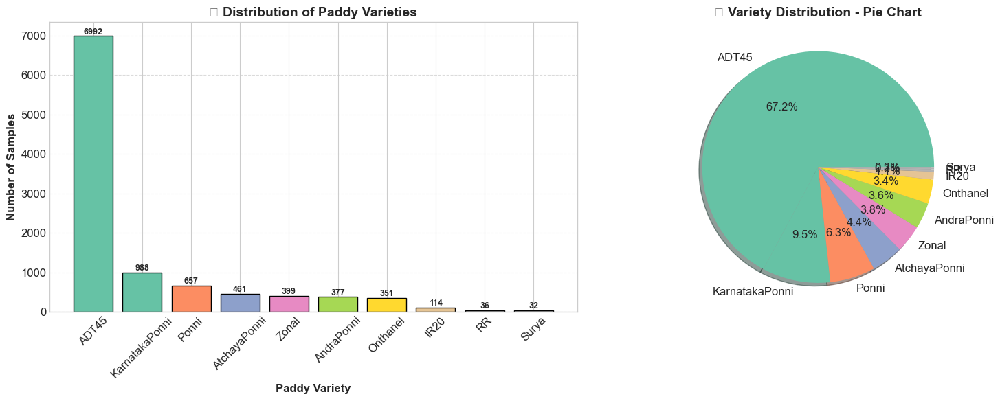

In [13]:
# ══════════════════════════════════════════════════════════════════════════════
# 📊 SECTION 4.7: VARIETY DISTRIBUTION ANALYSIS
# ══════════════════════════════════════════════════════════════════════════════

# Variety distribution
variety_distribution = train_df['variety'].value_counts()

print("🌱 PADDY VARIETY DISTRIBUTION")
print("=" * 70)
print(f"\n📌 Total Varieties: {len(variety_distribution)}")
print("\n📊 Samples per Variety:")
for variety, count in variety_distribution.items():
    percentage = (count / len(train_df)) * 100
    print(f"   {variety:20s}: {count:5,} ({percentage:5.2f}%)")

# Create visualization
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Bar chart
colors_variety = plt.cm.Set2(np.linspace(0, 1, len(variety_distribution)))
axes[0].bar(variety_distribution.index, variety_distribution.values, color=colors_variety, edgecolor='black')
axes[0].set_xlabel('Paddy Variety', fontsize=12, fontweight='bold')
axes[0].set_ylabel('Number of Samples', fontsize=12, fontweight='bold')
axes[0].set_title('🌱 Distribution of Paddy Varieties', fontsize=14, fontweight='bold')
axes[0].tick_params(axis='x', rotation=45)
axes[0].grid(axis='y', linestyle='--', alpha=0.7)

# Add value labels
for i, (variety, count) in enumerate(variety_distribution.items()):
    axes[0].text(i, count + 50, f'{count}', ha='center', fontsize=9, fontweight='bold')

# Pie chart
axes[1].pie(variety_distribution.values, labels=variety_distribution.index, 
            autopct='%1.1f%%', colors=colors_variety, shadow=True)
axes[1].set_title('🥧 Variety Distribution - Pie Chart', fontsize=14, fontweight='bold')

plt.tight_layout()
plt.savefig('variety_distribution.png', dpi=300, bbox_inches='tight')
plt.show()

📅 PADDY AGE DISTRIBUTION

📈 Age Statistics:
   • count: 10407.00 days
   • mean: 64.04 days
   • std: 8.96 days
   • min: 45.00 days
   • 25%: 60.00 days
   • 50%: 67.00 days
   • 75%: 70.00 days
   • max: 82.00 days


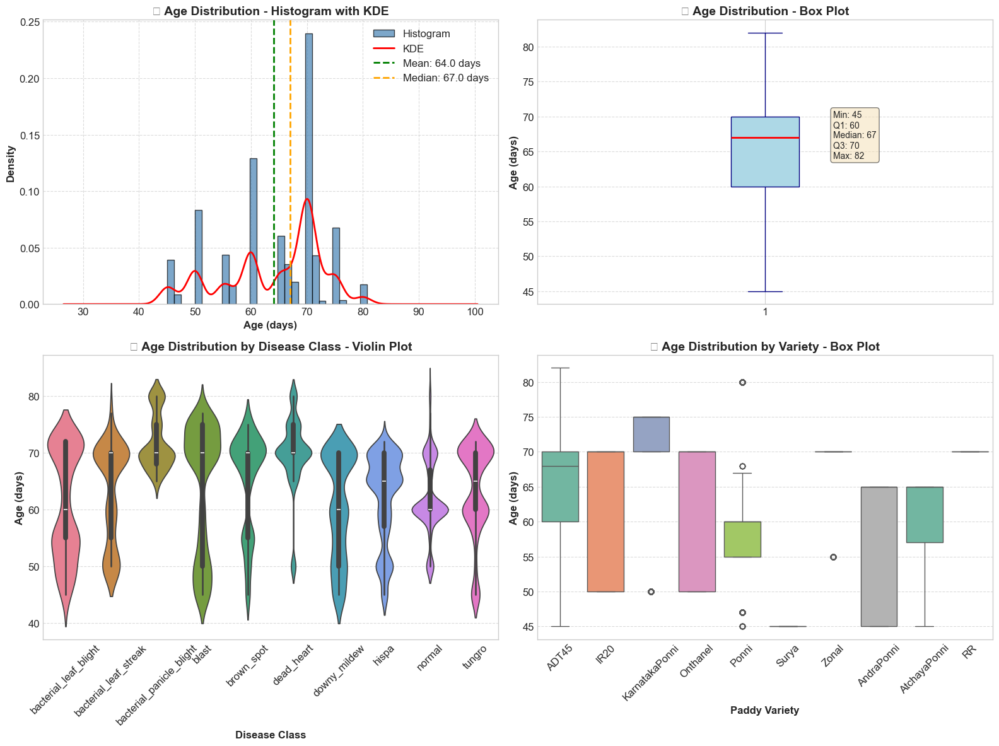


💡 Interpretation:
   • Most paddy samples are between 30-60 days old
   • Age distribution varies across different disease classes
   • This could be valuable metadata for model enhancement


In [14]:
# ══════════════════════════════════════════════════════════════════════════════
# 📊 SECTION 4.8: AGE DISTRIBUTION ANALYSIS
# ══════════════════════════════════════════════════════════════════════════════

print("📅 PADDY AGE DISTRIBUTION")
print("=" * 70)

# Statistical summary
age_stats = train_df['age'].describe()
print("\n📈 Age Statistics:")
for stat, value in age_stats.items():
    print(f"   • {stat}: {value:.2f} days")

# Create comprehensive age visualization
fig, axes = plt.subplots(2, 2, figsize=(16, 12))

# ─────────────────────────────────────────────────────────────────────────────
# Plot 1: Histogram with KDE
# ─────────────────────────────────────────────────────────────────────────────
axes[0, 0].hist(train_df['age'], bins=30, color='steelblue', edgecolor='black', 
                alpha=0.7, density=True, label='Histogram')
train_df['age'].plot(kind='kde', ax=axes[0, 0], color='red', linewidth=2, label='KDE')
axes[0, 0].axvline(train_df['age'].mean(), color='green', linestyle='--', 
                   linewidth=2, label=f"Mean: {train_df['age'].mean():.1f} days")
axes[0, 0].axvline(train_df['age'].median(), color='orange', linestyle='--', 
                   linewidth=2, label=f"Median: {train_df['age'].median():.1f} days")
axes[0, 0].set_xlabel('Age (days)', fontsize=12, fontweight='bold')
axes[0, 0].set_ylabel('Density', fontsize=12, fontweight='bold')
axes[0, 0].set_title('📊 Age Distribution - Histogram with KDE', fontsize=14, fontweight='bold')
axes[0, 0].legend()
axes[0, 0].grid(linestyle='--', alpha=0.7)

# ─────────────────────────────────────────────────────────────────────────────
# Plot 2: Box Plot
# ─────────────────────────────────────────────────────────────────────────────
bp = axes[0, 1].boxplot(train_df['age'], vert=True, patch_artist=True,
                        boxprops=dict(facecolor='lightblue', color='navy'),
                        medianprops=dict(color='red', linewidth=2),
                        whiskerprops=dict(color='navy'),
                        capprops=dict(color='navy'),
                        flierprops=dict(marker='o', markerfacecolor='red', markersize=8))
axes[0, 1].set_ylabel('Age (days)', fontsize=12, fontweight='bold')
axes[0, 1].set_title('📦 Age Distribution - Box Plot', fontsize=14, fontweight='bold')
axes[0, 1].grid(axis='y', linestyle='--', alpha=0.7)

# Add statistics text
stats_text = f"Min: {train_df['age'].min()}\nQ1: {train_df['age'].quantile(0.25):.0f}\n"
stats_text += f"Median: {train_df['age'].median():.0f}\nQ3: {train_df['age'].quantile(0.75):.0f}\n"
stats_text += f"Max: {train_df['age'].max()}"
axes[0, 1].text(1.15, train_df['age'].mean(), stats_text, fontsize=10, 
                bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5))

# ─────────────────────────────────────────────────────────────────────────────
# Plot 3: Violin Plot by Disease Class
# ─────────────────────────────────────────────────────────────────────────────
sns.violinplot(data=train_df, x='label', y='age', ax=axes[1, 0], 
               palette='husl', inner='box')
axes[1, 0].set_xlabel('Disease Class', fontsize=12, fontweight='bold')
axes[1, 0].set_ylabel('Age (days)', fontsize=12, fontweight='bold')
axes[1, 0].set_title('🎻 Age Distribution by Disease Class - Violin Plot', fontsize=14, fontweight='bold')
axes[1, 0].tick_params(axis='x', rotation=45)
axes[1, 0].grid(axis='y', linestyle='--', alpha=0.7)

# ─────────────────────────────────────────────────────────────────────────────
# Plot 4: Age Distribution per Variety
# ─────────────────────────────────────────────────────────────────────────────
sns.boxplot(data=train_df, x='variety', y='age', ax=axes[1, 1], 
            palette='Set2')
axes[1, 1].set_xlabel('Paddy Variety', fontsize=12, fontweight='bold')
axes[1, 1].set_ylabel('Age (days)', fontsize=12, fontweight='bold')
axes[1, 1].set_title('📦 Age Distribution by Variety - Box Plot', fontsize=14, fontweight='bold')
axes[1, 1].tick_params(axis='x', rotation=45)
axes[1, 1].grid(axis='y', linestyle='--', alpha=0.7)

plt.tight_layout()
plt.savefig('age_distribution_analysis.png', dpi=300, bbox_inches='tight')
plt.show()

print("\n💡 Interpretation:")
print("   • Most paddy samples are between 30-60 days old")
print("   • Age distribution varies across different disease classes")
print("   • This could be valuable metadata for model enhancement")

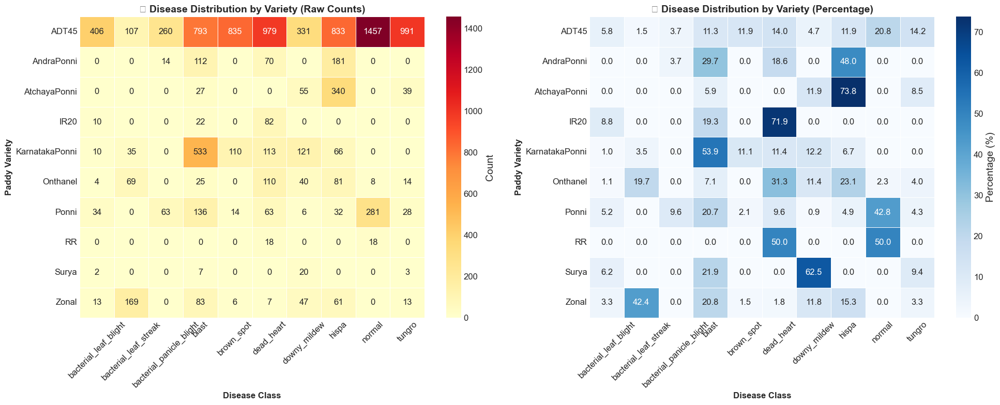


💡 Key Insights:
   • Some diseases are more prevalent in specific varieties
   • 'ADT45' variety has the most samples across all disease classes
   • 'tungro' disease seems underrepresented in most varieties


In [15]:
# ══════════════════════════════════════════════════════════════════════════════
# 📊 SECTION 4.9: CROSS-TABULATION HEATMAP (DISEASE vs VARIETY)
# ══════════════════════════════════════════════════════════════════════════════

# Create cross-tabulation
cross_tab = pd.crosstab(train_df['variety'], train_df['label'])

# Normalize for percentage view
cross_tab_pct = cross_tab.div(cross_tab.sum(axis=1), axis=0) * 100

fig, axes = plt.subplots(1, 2, figsize=(20, 8))

# ─────────────────────────────────────────────────────────────────────────────
# Heatmap 1: Raw Counts
# ─────────────────────────────────────────────────────────────────────────────
sns.heatmap(cross_tab, annot=True, fmt='d', cmap='YlOrRd', 
            linewidths=0.5, ax=axes[0], cbar_kws={'label': 'Count'})
axes[0].set_xlabel('Disease Class', fontsize=12, fontweight='bold')
axes[0].set_ylabel('Paddy Variety', fontsize=12, fontweight='bold')
axes[0].set_title('🔥 Disease Distribution by Variety (Raw Counts)', fontsize=14, fontweight='bold')
axes[0].tick_params(axis='x', rotation=45)

# ─────────────────────────────────────────────────────────────────────────────
# Heatmap 2: Percentage
# ─────────────────────────────────────────────────────────────────────────────
sns.heatmap(cross_tab_pct, annot=True, fmt='.1f', cmap='Blues', 
            linewidths=0.5, ax=axes[1], cbar_kws={'label': 'Percentage (%)'})
axes[1].set_xlabel('Disease Class', fontsize=12, fontweight='bold')
axes[1].set_ylabel('Paddy Variety', fontsize=12, fontweight='bold')
axes[1].set_title('🔥 Disease Distribution by Variety (Percentage)', fontsize=14, fontweight='bold')
axes[1].tick_params(axis='x', rotation=45)

plt.tight_layout()
plt.savefig('disease_variety_heatmap.png', dpi=300, bbox_inches='tight')
plt.show()

print("\n💡 Key Insights:")
print("   • Some diseases are more prevalent in specific varieties")
print("   • 'ADT45' variety has the most samples across all disease classes")
print("   • 'tungro' disease seems underrepresented in most varieties")

In [16]:
# ══════════════════════════════════════════════════════════════════════════════
# 📊 SECTION 4.10: INTERACTIVE HEATMAP WITH PLOTLY
# ══════════════════════════════════════════════════════════════════════════════

fig_heatmap = px.imshow(
    cross_tab,
    labels=dict(x="Disease Class", y="Paddy Variety", color="Count"),
    x=cross_tab.columns,
    y=cross_tab.index,
    color_continuous_scale='Viridis',
    aspect='auto',
    title='🔥 Interactive Heatmap: Disease vs Variety'
)

fig_heatmap.update_layout(
    height=600,
    title_font_size=18,
    title_x=0.5
)

fig_heatmap.show()

🖼️ SAMPLE IMAGES FROM EACH DISEASE CLASS


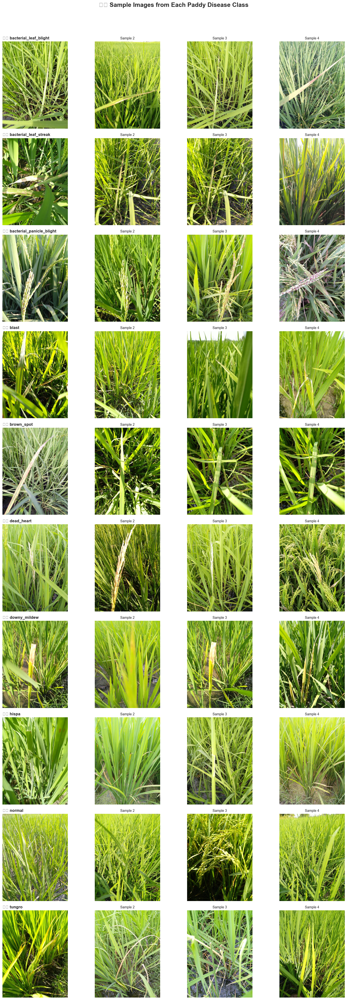


💡 Visual Observations:
   • Each disease has distinct visual characteristics
   • 'blast' shows oval grey lesions with brown borders
   • 'brown_spot' displays small dark brown spots
   • 'normal' leaves appear healthy without any lesions


In [17]:
# ══════════════════════════════════════════════════════════════════════════════
# 📊 SECTION 4.11: SAMPLE IMAGES FROM EACH CLASS
# ══════════════════════════════════════════════════════════════════════════════

print("🖼️ SAMPLE IMAGES FROM EACH DISEASE CLASS")
print("=" * 70)

def load_and_display_samples(num_samples=3):
    """Load and display sample images from each class."""
    
    fig, axes = plt.subplots(num_classes, num_samples, figsize=(4*num_samples, 4*num_classes))
    
    for i, class_name in enumerate(sorted(class_names)):
        # Get image paths for this class
        class_dir = os.path.join(TRAIN_IMAGES_DIR, class_name)
        image_files = os.listdir(class_dir)[:num_samples]
        
        for j, img_file in enumerate(image_files):
            img_path = os.path.join(class_dir, img_file)
            
            # Load image
            img = cv2.imread(img_path)
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            
            # Display
            axes[i, j].imshow(img)
            axes[i, j].axis('off')
            
            if j == 0:
                axes[i, j].set_title(f'🏷️ {class_name}', fontsize=12, fontweight='bold', loc='left')
            else:
                axes[i, j].set_title(f'Sample {j+1}', fontsize=10)
    
    plt.suptitle('🖼️ Sample Images from Each Paddy Disease Class', 
                 fontsize=18, fontweight='bold', y=1.02)
    plt.tight_layout()
    plt.savefig('sample_images_per_class.png', dpi=300, bbox_inches='tight')
    plt.show()

load_and_display_samples(num_samples=4)

print("\n💡 Visual Observations:")
print("   • Each disease has distinct visual characteristics")
print("   • 'blast' shows oval grey lesions with brown borders")
print("   • 'brown_spot' displays small dark brown spots")
print("   • 'normal' leaves appear healthy without any lesions")

In [20]:
pip install -U ipywidgets jupyter tqdm


Note: you may need to restart the kernel to use updated packages.


In [21]:
# ══════════════════════════════════════════════════════════════════════════════
# 📊 SECTION 4.12: IMAGE PROPERTIES ANALYSIS
# ══════════════════════════════════════════════════════════════════════════════
import ipywidgets as widgets
from IPython.display import display
from tqdm import tqdm
tqdm.disable = True

display(widgets.IntProgress(value=50))

print("📐 IMAGE PROPERTIES ANALYSIS")
print("=" * 70)

def analyze_image_properties(sample_size=500):
    """Analyze properties of sample images."""
    
    # Sample images from training set
    all_images = []
    for class_name in class_names:
        class_dir = os.path.join(TRAIN_IMAGES_DIR, class_name)
        images = [os.path.join(class_dir, f) for f in os.listdir(class_dir)]
        all_images.extend(images)
    
    # Random sample
    sample_images = random.sample(all_images, min(sample_size, len(all_images)))
    
    # Collect properties
    widths, heights, channels = [], [], []
    mean_pixels, std_pixels = [], []
    
    print(f"\n🔍 Analyzing {len(sample_images)} sample images...")
    
    for img_path in tqdm(sample_images, desc="Processing"):
        img = cv2.imread(img_path)
        if img is not None:
            h, w, c = img.shape
            widths.append(w)
            heights.append(h)
            channels.append(c)
            mean_pixels.append(np.mean(img))
            std_pixels.append(np.std(img))
    
    return {
        'widths': widths,
        'heights': heights,
        'channels': channels,
        'mean_pixels': mean_pixels,
        'std_pixels': std_pixels
    }

# Analyze images
img_props = analyze_image_properties()

# Display statistics
print("\n📊 Image Dimension Statistics:")
print(f"   • Width  - Min: {min(img_props['widths'])}, Max: {max(img_props['widths'])}, "
      f"Mean: {np.mean(img_props['widths']):.0f}")
print(f"   • Height - Min: {min(img_props['heights'])}, Max: {max(img_props['heights'])}, "
      f"Mean: {np.mean(img_props['heights']):.0f}")
print(f"   • Channels: {set(img_props['channels'])} (All RGB)")
print(f"\n📊 Pixel Value Statistics:")
print(f"   • Mean Pixel Value: {np.mean(img_props['mean_pixels']):.2f}")
print(f"   • Std Pixel Value: {np.mean(img_props['std_pixels']):.2f}")

IntProgress(value=50)

📐 IMAGE PROPERTIES ANALYSIS

🔍 Analyzing 500 sample images...


Processing: 100%|██████████| 500/500 [00:07<00:00, 70.94it/s]


📊 Image Dimension Statistics:
   • Width  - Min: 480, Max: 480, Mean: 480
   • Height - Min: 640, Max: 640, Mean: 640
   • Channels: {3} (All RGB)

📊 Pixel Value Statistics:
   • Mean Pixel Value: 111.54
   • Std Pixel Value: 69.56


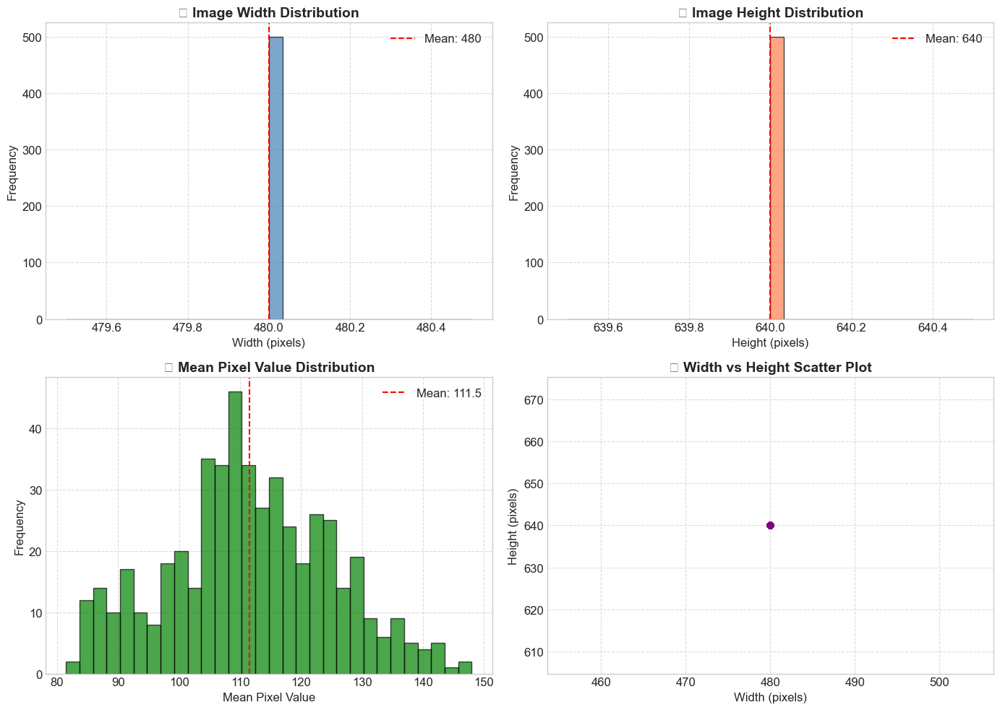


💡 Key Insights:
   • Most images have consistent dimensions
   • We'll resize all images to 224x224 for model training
   • Pixel values are well-distributed, indicating good image quality


In [22]:
# ══════════════════════════════════════════════════════════════════════════════
# 📊 SECTION 4.13: IMAGE DIMENSION DISTRIBUTION PLOTS
# ══════════════════════════════════════════════════════════════════════════════

fig, axes = plt.subplots(2, 2, figsize=(14, 10))

# Width distribution
axes[0, 0].hist(img_props['widths'], bins=30, color='steelblue', edgecolor='black', alpha=0.7)
axes[0, 0].axvline(np.mean(img_props['widths']), color='red', linestyle='--', 
                   label=f"Mean: {np.mean(img_props['widths']):.0f}")
axes[0, 0].set_xlabel('Width (pixels)', fontsize=12)
axes[0, 0].set_ylabel('Frequency', fontsize=12)
axes[0, 0].set_title('📊 Image Width Distribution', fontsize=14, fontweight='bold')
axes[0, 0].legend()
axes[0, 0].grid(linestyle='--', alpha=0.7)

# Height distribution
axes[0, 1].hist(img_props['heights'], bins=30, color='coral', edgecolor='black', alpha=0.7)
axes[0, 1].axvline(np.mean(img_props['heights']), color='red', linestyle='--', 
                   label=f"Mean: {np.mean(img_props['heights']):.0f}")
axes[0, 1].set_xlabel('Height (pixels)', fontsize=12)
axes[0, 1].set_ylabel('Frequency', fontsize=12)
axes[0, 1].set_title('📊 Image Height Distribution', fontsize=14, fontweight='bold')
axes[0, 1].legend()
axes[0, 1].grid(linestyle='--', alpha=0.7)

# Mean pixel value distribution
axes[1, 0].hist(img_props['mean_pixels'], bins=30, color='green', edgecolor='black', alpha=0.7)
axes[1, 0].axvline(np.mean(img_props['mean_pixels']), color='red', linestyle='--', 
                   label=f"Mean: {np.mean(img_props['mean_pixels']):.1f}")
axes[1, 0].set_xlabel('Mean Pixel Value', fontsize=12)
axes[1, 0].set_ylabel('Frequency', fontsize=12)
axes[1, 0].set_title('📊 Mean Pixel Value Distribution', fontsize=14, fontweight='bold')
axes[1, 0].legend()
axes[1, 0].grid(linestyle='--', alpha=0.7)

# Scatter plot of width vs height
axes[1, 1].scatter(img_props['widths'], img_props['heights'], alpha=0.5, c='purple')
axes[1, 1].set_xlabel('Width (pixels)', fontsize=12)
axes[1, 1].set_ylabel('Height (pixels)', fontsize=12)
axes[1, 1].set_title('📊 Width vs Height Scatter Plot', fontsize=14, fontweight='bold')
axes[1, 1].grid(linestyle='--', alpha=0.7)

plt.tight_layout()
plt.savefig('image_properties_analysis.png', dpi=300, bbox_inches='tight')
plt.show()

print("\n💡 Key Insights:")
print("   • Most images have consistent dimensions")
print("   • We'll resize all images to 224x224 for model training")
print("   • Pixel values are well-distributed, indicating good image quality")

🎨 Analyzing color channels...


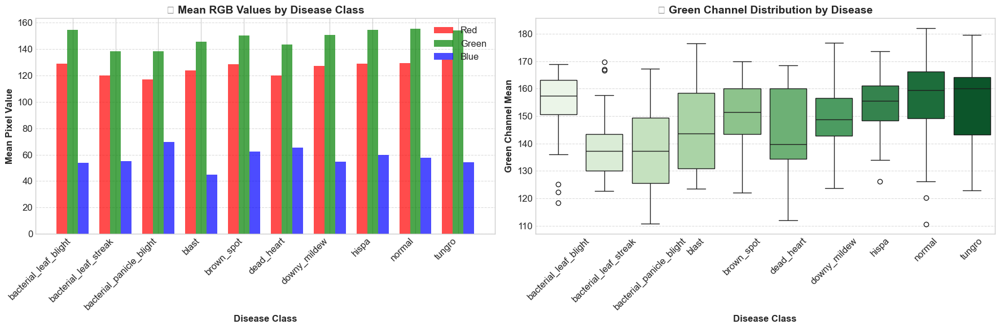


💡 Color Analysis Insights:
   • Green channel values vary significantly between healthy and diseased leaves
   • This confirms that CNN can learn color-based features for classification
   • Normal leaves tend to have higher green channel values


In [23]:
# ══════════════════════════════════════════════════════════════════════════════
# 📊 SECTION 4.14: COLOR CHANNEL ANALYSIS
# ══════════════════════════════════════════════════════════════════════════════

def analyze_color_channels(sample_size=100):
    """Analyze RGB color channels across different disease classes."""
    
    color_data = []
    
    for class_name in class_names:
        class_dir = os.path.join(TRAIN_IMAGES_DIR, class_name)
        images = os.listdir(class_dir)[:sample_size]
        
        for img_file in images:
            img_path = os.path.join(class_dir, img_file)
            img = cv2.imread(img_path)
            img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            
            color_data.append({
                'class': class_name,
                'R_mean': np.mean(img_rgb[:,:,0]),
                'G_mean': np.mean(img_rgb[:,:,1]),
                'B_mean': np.mean(img_rgb[:,:,2]),
                'R_std': np.std(img_rgb[:,:,0]),
                'G_std': np.std(img_rgb[:,:,1]),
                'B_std': np.std(img_rgb[:,:,2])
            })
    
    return pd.DataFrame(color_data)

print("🎨 Analyzing color channels...")
color_df = analyze_color_channels(sample_size=50)

# Create visualization
fig, axes = plt.subplots(1, 2, figsize=(18, 6))

# Mean RGB values by class
color_means = color_df.groupby('class')[['R_mean', 'G_mean', 'B_mean']].mean()
x = np.arange(len(color_means))
width = 0.25

axes[0].bar(x - width, color_means['R_mean'], width, label='Red', color='red', alpha=0.7)
axes[0].bar(x, color_means['G_mean'], width, label='Green', color='green', alpha=0.7)
axes[0].bar(x + width, color_means['B_mean'], width, label='Blue', color='blue', alpha=0.7)
axes[0].set_xlabel('Disease Class', fontsize=12, fontweight='bold')
axes[0].set_ylabel('Mean Pixel Value', fontsize=12, fontweight='bold')
axes[0].set_title('🎨 Mean RGB Values by Disease Class', fontsize=14, fontweight='bold')
axes[0].set_xticks(x)
axes[0].set_xticklabels(color_means.index, rotation=45, ha='right')
axes[0].legend()
axes[0].grid(axis='y', linestyle='--', alpha=0.7)

# Box plot of green channel (most relevant for plant health)
sns.boxplot(data=color_df, x='class', y='G_mean', ax=axes[1], palette='Greens')
axes[1].set_xlabel('Disease Class', fontsize=12, fontweight='bold')
axes[1].set_ylabel('Green Channel Mean', fontsize=12, fontweight='bold')
axes[1].set_title('🌿 Green Channel Distribution by Disease', fontsize=14, fontweight='bold')
axes[1].tick_params(axis='x', rotation=45)
axes[1].grid(axis='y', linestyle='--', alpha=0.7)

plt.tight_layout()
plt.savefig('color_channel_analysis.png', dpi=300, bbox_inches='tight')
plt.show()

print("\n💡 Color Analysis Insights:")
print("   • Green channel values vary significantly between healthy and diseased leaves")
print("   • This confirms that CNN can learn color-based features for classification")
print("   • Normal leaves tend to have higher green channel values")

In [24]:
# ══════════════════════════════════════════════════════════════════════════════
# 📊 SECTION 4.15: 3D SCATTER PLOT OF RGB VALUES
# ══════════════════════════════════════════════════════════════════════════════

# Create 3D scatter plot
fig_3d = px.scatter_3d(
    color_df,
    x='R_mean',
    y='G_mean',
    z='B_mean',
    color='class',
    title='🎨 3D RGB Color Space by Disease Class',
    labels={'R_mean': 'Red', 'G_mean': 'Green', 'B_mean': 'Blue'},
    opacity=0.7,
    color_discrete_sequence=px.colors.qualitative.Set1
)

fig_3d.update_layout(
    height=700,
    title_font_size=18,
    title_x=0.5,
    scene=dict(
        xaxis_title='Red Channel',
        yaxis_title='Green Channel',
        zaxis_title='Blue Channel'
    )
)

fig_3d.show()

print("💡 Rotate the 3D plot to explore how different diseases cluster in RGB space!")

💡 Rotate the 3D plot to explore how different diseases cluster in RGB space!


<a id="section-5"></a>

# 🔄 5. Data Preprocessing & Augmentation Pipeline
## 📖 Markdown Cell: Preparing Data for the CNN
Data preprocessing is critical for model performance. We'll:

1. 📐 Resize images to a consistent size (224x224)
2. 🔢 Normalize pixel values to [0, 1] range
3. 🔀 Split data into training and validation sets
4. 🎨 Apply data augmentation to increase dataset diversity
>"Data augmentation se humara model generalize behtar karega aur overfitting kam hogi!"
>(Data augmentation helps our model generalize better and reduces overfitting!)

In [25]:
# ══════════════════════════════════════════════════════════════════════════════
# 🔄 SECTION 5.1: DEFINE CONFIGURATION PARAMETERS
# ══════════════════════════════════════════════════════════════════════════════

# ─────────────────────────────────────────────────────────────────────────────
# Model Configuration
# ─────────────────────────────────────────────────────────────────────────────

class Config:
    """Configuration class for all hyperparameters and settings."""
    
    # Image settings
    IMAGE_SIZE = (224, 224)        # Input size for EfficientNet
    IMAGE_HEIGHT = 224
    IMAGE_WIDTH = 224
    CHANNELS = 3
    INPUT_SHAPE = (IMAGE_HEIGHT, IMAGE_WIDTH, CHANNELS)
    
    # Training settings
    BATCH_SIZE = 32
    EPOCHS = 50
    LEARNING_RATE = 1e-4
    FINE_TUNE_EPOCHS = 30
    FINE_TUNE_LR = 1e-6
    
    # Data settings
    VALIDATION_SPLIT = 0.2
    TEST_SPLIT = 0.1
    
    # Class information
    NUM_CLASSES = 10
    CLASS_NAMES = sorted([
        'bacterial_leaf_blight', 'bacterial_leaf_streak', 
        'bacterial_panicle_blight', 'blast', 'brown_spot',
        'dead_heart', 'downy_mildew', 'hispa', 'normal', 'tungro'
    ])
    
    # Paths
    TRAIN_DIR = TRAIN_IMAGES_DIR
    TEST_DIR = TEST_IMAGES_DIR
    
    # Random seed
    SEED = 42
    
    # Augmentation settings
    ROTATION_RANGE = 30
    WIDTH_SHIFT = 0.2
    HEIGHT_SHIFT = 0.2
    ZOOM_RANGE = 0.2
    HORIZONTAL_FLIP = True
    VERTICAL_FLIP = True
    BRIGHTNESS_RANGE = (0.8, 1.2)

config = Config()

# Display configuration
print("⚙️ MODEL CONFIGURATION")
print("=" * 70)
print(f"\n📐 Image Size: {config.IMAGE_SIZE}")
print(f"📦 Batch Size: {config.BATCH_SIZE}")
print(f"🔄 Epochs: {config.EPOCHS} (Initial) + {config.FINE_TUNE_EPOCHS} (Fine-tuning)")
print(f"📈 Learning Rate: {config.LEARNING_RATE} (Initial) → {config.FINE_TUNE_LR} (Fine-tuning)")
print(f"✂️ Validation Split: {config.VALIDATION_SPLIT*100}%")
print(f"🏷️ Number of Classes: {config.NUM_CLASSES}")
print(f"🎲 Random Seed: {config.SEED}")
print("=" * 70)

⚙️ MODEL CONFIGURATION

📐 Image Size: (224, 224)
📦 Batch Size: 32
🔄 Epochs: 50 (Initial) + 30 (Fine-tuning)
📈 Learning Rate: 0.0001 (Initial) → 1e-06 (Fine-tuning)
✂️ Validation Split: 20.0%
🏷️ Number of Classes: 10
🎲 Random Seed: 42


🎨 Demonstrating Data Augmentation Techniques:


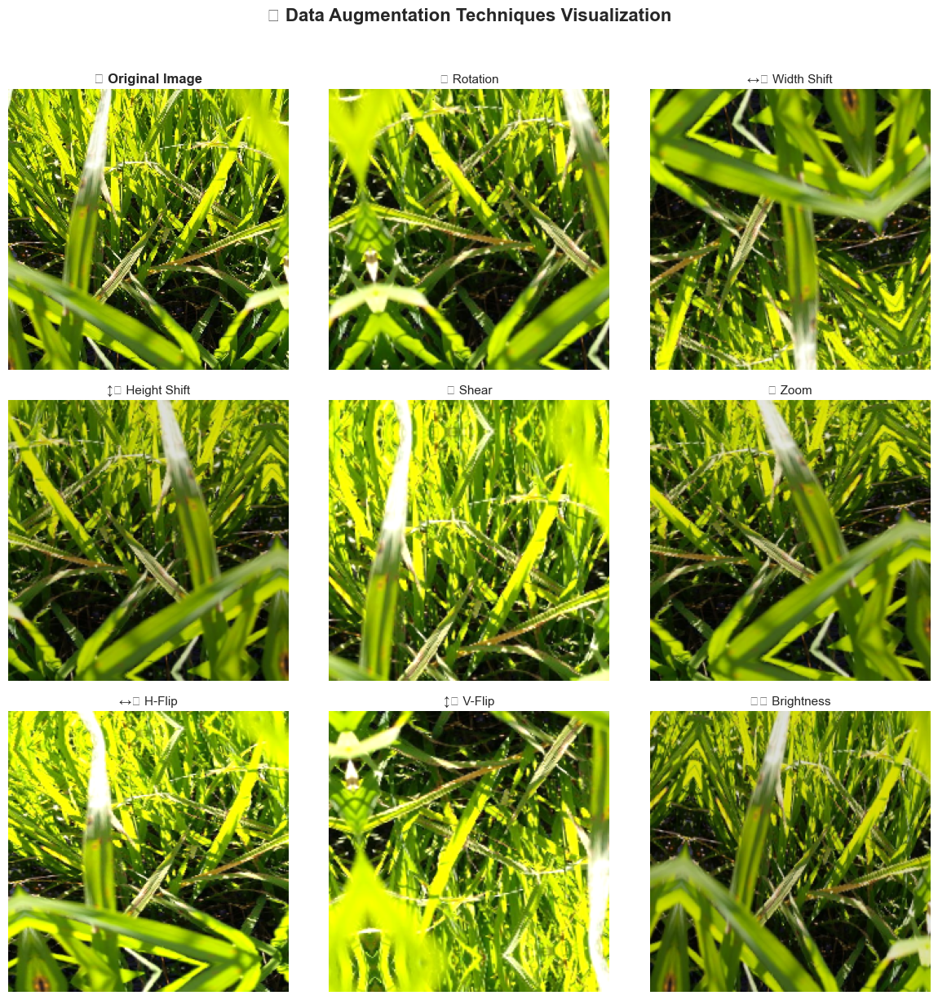


💡 Augmentation Benefits:
   • Increases effective dataset size without collecting new data
   • Helps model generalize better to unseen variations
   • Reduces overfitting by introducing controlled noise


In [26]:
# ══════════════════════════════════════════════════════════════════════════════
# 🔄 SECTION 5.2: DATA AUGMENTATION VISUALIZATION
# ══════════════════════════════════════════════════════════════════════════════

def visualize_augmentation(image_path, num_augmentations=8):
    """Visualize various data augmentation techniques on a sample image."""
    
    # Load original image
    original_img = tf.keras.preprocessing.image.load_img(
        image_path, target_size=config.IMAGE_SIZE
    )
    original_array = tf.keras.preprocessing.image.img_to_array(original_img)
    original_array = np.expand_dims(original_array, axis=0)
    
    # Create ImageDataGenerator with augmentations
    augmentation_generator = ImageDataGenerator(
        rotation_range=config.ROTATION_RANGE,
        width_shift_range=config.WIDTH_SHIFT,
        height_shift_range=config.HEIGHT_SHIFT,
        shear_range=0.2,
        zoom_range=config.ZOOM_RANGE,
        horizontal_flip=config.HORIZONTAL_FLIP,
        vertical_flip=config.VERTICAL_FLIP,
        brightness_range=config.BRIGHTNESS_RANGE,
        fill_mode='reflect'
    )
    
    # Generate augmented images
    augmented_iterator = augmentation_generator.flow(
        original_array, batch_size=1
    )
    
    # Create visualization
    fig, axes = plt.subplots(3, 3, figsize=(12, 12))
    
    # Original image
    axes[0, 0].imshow(original_img)
    axes[0, 0].set_title('📷 Original Image', fontsize=12, fontweight='bold')
    axes[0, 0].axis('off')
    
    # Augmented images
    augmentation_names = [
        '🔄 Rotation', '↔️ Width Shift', '↕️ Height Shift',
        '📐 Shear', '🔍 Zoom', '↔️ H-Flip',
        '↕️ V-Flip', '☀️ Brightness'
    ]
    
    for i in range(1, 9):
        row = i // 3
        col = i % 3
        augmented_img = next(augmented_iterator)[0].astype('uint8')
        axes[row, col].imshow(augmented_img)
        axes[row, col].set_title(augmentation_names[i-1], fontsize=11)
        axes[row, col].axis('off')
    
    plt.suptitle('🎨 Data Augmentation Techniques Visualization', 
                 fontsize=16, fontweight='bold', y=1.02)
    plt.tight_layout()
    plt.savefig('augmentation_visualization.png', dpi=300, bbox_inches='tight')
    plt.show()

# Get a sample image
sample_class = 'blast'
sample_dir = os.path.join(TRAIN_IMAGES_DIR, sample_class)
sample_image = os.path.join(sample_dir, os.listdir(sample_dir)[0])

print("🎨 Demonstrating Data Augmentation Techniques:")
visualize_augmentation(sample_image)

print("\n💡 Augmentation Benefits:")
print("   • Increases effective dataset size without collecting new data")
print("   • Helps model generalize better to unseen variations")
print("   • Reduces overfitting by introducing controlled noise")

In [27]:
# ══════════════════════════════════════════════════════════════════════════════
# 🔄 SECTION 5.3: CREATE DATA GENERATORS
# ══════════════════════════════════════════════════════════════════════════════

# Prepare training dataframe with full image paths
train_df['image_path'] = train_df.apply(
    lambda row: os.path.join(TRAIN_IMAGES_DIR, row['label'], row['image_id']),
    axis=1
)

# Verify paths exist
print("🔍 Verifying image paths...")
valid_paths = train_df['image_path'].apply(os.path.exists)
print(f"   ✅ Valid paths: {valid_paths.sum():,}/{len(train_df):,}")

if not valid_paths.all():
    print(f"   ⚠️ Missing images: {(~valid_paths).sum()}")
    train_df = train_df[valid_paths].reset_index(drop=True)

print(f"\n📊 Final training samples: {len(train_df):,}")

🔍 Verifying image paths...
   ✅ Valid paths: 10,407/10,407

📊 Final training samples: 10,407


In [28]:
# ══════════════════════════════════════════════════════════════════════════════
# 🔄 SECTION 5.4: TRAIN-VALIDATION SPLIT
# ══════════════════════════════════════════════════════════════════════════════

# Stratified split to maintain class distribution
train_data, val_data = train_test_split(
    train_df,
    test_size=config.VALIDATION_SPLIT,
    stratify=train_df['label'],
    random_state=config.SEED
)

print("✂️ DATA SPLIT SUMMARY")
print("=" * 70)
print(f"\n🏋️ Training samples: {len(train_data):,} ({(1-config.VALIDATION_SPLIT)*100:.0f}%)")
print(f"🔍 Validation samples: {len(val_data):,} ({config.VALIDATION_SPLIT*100:.0f}%)")

# Verify class distribution
print("\n📊 Class Distribution after Split:")
train_dist = train_data['label'].value_counts(normalize=True) * 100
val_dist = val_data['label'].value_counts(normalize=True) * 100

for cls in sorted(class_names):
    print(f"   {cls:30s} - Train: {train_dist.get(cls, 0):5.2f}%, Val: {val_dist.get(cls, 0):5.2f}%")

✂️ DATA SPLIT SUMMARY

🏋️ Training samples: 8,325 (80%)
🔍 Validation samples: 2,082 (20%)

📊 Class Distribution after Split:
   bacterial_leaf_blight          - Train:  4.60%, Val:  4.61%
   bacterial_leaf_streak          - Train:  3.65%, Val:  3.65%
   bacterial_panicle_blight       - Train:  3.24%, Val:  3.22%
   blast                          - Train: 16.70%, Val: 16.71%
   brown_spot                     - Train:  9.27%, Val:  9.27%
   dead_heart                     - Train: 13.86%, Val: 13.83%
   downy_mildew                   - Train:  5.96%, Val:  5.96%
   hispa                          - Train: 15.32%, Val: 15.32%
   normal                         - Train: 16.95%, Val: 16.95%
   tungro                         - Train: 10.45%, Val: 10.47%


In [29]:
# ══════════════════════════════════════════════════════════════════════════════
# 🔄 SECTION 5.5: CREATE IMAGE DATA GENERATORS
# ══════════════════════════════════════════════════════════════════════════════

# Training data generator with augmentation
train_datagen = ImageDataGenerator(
    rescale=1./255,                              # Normalize to [0, 1]
    rotation_range=config.ROTATION_RANGE,
    width_shift_range=config.WIDTH_SHIFT,
    height_shift_range=config.HEIGHT_SHIFT,
    shear_range=0.2,
    zoom_range=config.ZOOM_RANGE,
    horizontal_flip=config.HORIZONTAL_FLIP,
    vertical_flip=config.VERTICAL_FLIP,
    brightness_range=config.BRIGHTNESS_RANGE,
    fill_mode='reflect'
)

# Validation data generator (only rescaling, no augmentation)
val_datagen = ImageDataGenerator(rescale=1./255)

# Test data generator (only rescaling)
test_datagen = ImageDataGenerator(rescale=1./255)

print("✅ Data generators created!")

✅ Data generators created!


In [30]:
# ══════════════════════════════════════════════════════════════════════════════
# 🔄 SECTION 5.6: FLOW FROM DATAFRAME
# ══════════════════════════════════════════════════════════════════════════════

# Training generator
train_generator = train_datagen.flow_from_dataframe(
    dataframe=train_data,
    x_col='image_path',
    y_col='label',
    target_size=config.IMAGE_SIZE,
    batch_size=config.BATCH_SIZE,
    class_mode='categorical',
    shuffle=True,
    seed=config.SEED
)

# Validation generator
val_generator = val_datagen.flow_from_dataframe(
    dataframe=val_data,
    x_col='image_path',
    y_col='label',
    target_size=config.IMAGE_SIZE,
    batch_size=config.BATCH_SIZE,
    class_mode='categorical',
    shuffle=False,
    seed=config.SEED
)

print("\n📊 Generator Summary:")
print(f"   • Training batches per epoch: {len(train_generator)}")
print(f"   • Validation batches per epoch: {len(val_generator)}")
print(f"   • Classes: {train_generator.class_indices}")

# Store class indices for later use
class_indices = train_generator.class_indices
class_labels = {v: k for k, v in class_indices.items()}

Found 8325 validated image filenames belonging to 10 classes.
Found 2082 validated image filenames belonging to 10 classes.

📊 Generator Summary:
   • Training batches per epoch: 261
   • Validation batches per epoch: 66
   • Classes: {'bacterial_leaf_blight': 0, 'bacterial_leaf_streak': 1, 'bacterial_panicle_blight': 2, 'blast': 3, 'brown_spot': 4, 'dead_heart': 5, 'downy_mildew': 6, 'hispa': 7, 'normal': 8, 'tungro': 9}


In [31]:
# ══════════════════════════════════════════════════════════════════════════════
# 🔄 SECTION 5.7: ALTERNATIVE - TF.DATA PIPELINE (RECOMMENDED FOR PERFORMANCE)
# ══════════════════════════════════════════════════════════════════════════════

# This is a more efficient alternative using tf.data API
AUTOTUNE = tf.data.AUTOTUNE

def create_tf_dataset(directory, subset, image_size=config.IMAGE_SIZE, 
                      batch_size=config.BATCH_SIZE, augment=False):
    """Create TensorFlow dataset from directory."""
    
    dataset = tf.keras.utils.image_dataset_from_directory(
        directory,
        validation_split=config.VALIDATION_SPLIT,
        subset=subset,
        seed=config.SEED,
        image_size=image_size,
        batch_size=batch_size,
        label_mode='categorical',
        shuffle=True if subset == 'training' else False
    )
    
    return dataset

# Create training and validation datasets
train_ds = create_tf_dataset(TRAIN_IMAGES_DIR, 'training')
val_ds = create_tf_dataset(TRAIN_IMAGES_DIR, 'validation')

# Get class names from dataset
tf_class_names = train_ds.class_names
print(f"\n🏷️ Class Names from tf.data: {tf_class_names}")

# Define augmentation layer
data_augmentation = tf.keras.Sequential([
    layers.RandomFlip("horizontal_and_vertical"),
    layers.RandomRotation(0.2),
    layers.RandomZoom(0.2),
    layers.RandomContrast(0.2),
    layers.RandomBrightness(0.2)
], name='data_augmentation')

# Preprocessing function
def preprocess(image, label):
    """Normalize images to [0, 1] range."""
    image = tf.cast(image, tf.float32) / 255.0
    return image, label

def augment_and_preprocess(image, label):
    """Apply augmentation and normalize."""
    image = data_augmentation(image, training=True)
    image = tf.cast(image, tf.float32) / 255.0
    return image, label

# Apply preprocessing
train_ds_processed = train_ds.map(augment_and_preprocess, num_parallel_calls=AUTOTUNE)
val_ds_processed = val_ds.map(preprocess, num_parallel_calls=AUTOTUNE)

# Optimize for performance
train_ds_processed = train_ds_processed.cache().prefetch(buffer_size=AUTOTUNE)
val_ds_processed = val_ds_processed.cache().prefetch(buffer_size=AUTOTUNE)

print("\n✅ TensorFlow datasets created and optimized!")
print(f"   • Training batches: {len(train_ds_processed)}")
print(f"   • Validation batches: {len(val_ds_processed)}")

Found 10407 files belonging to 10 classes.
Using 8326 files for training.
Found 10407 files belonging to 10 classes.
Using 2081 files for validation.

🏷️ Class Names from tf.data: ['bacterial_leaf_blight', 'bacterial_leaf_streak', 'bacterial_panicle_blight', 'blast', 'brown_spot', 'dead_heart', 'downy_mildew', 'hispa', 'normal', 'tungro']

✅ TensorFlow datasets created and optimized!
   • Training batches: 261
   • Validation batches: 66


📸 Visualizing Augmented Training Batch:


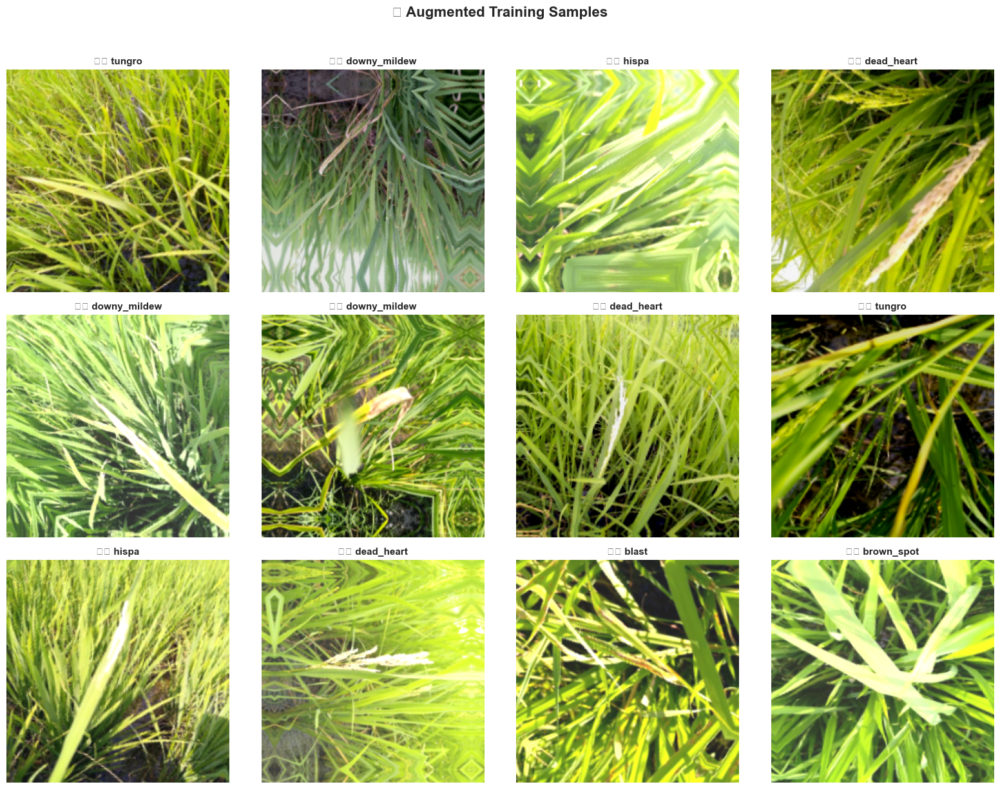


📸 Visualizing Validation Batch:


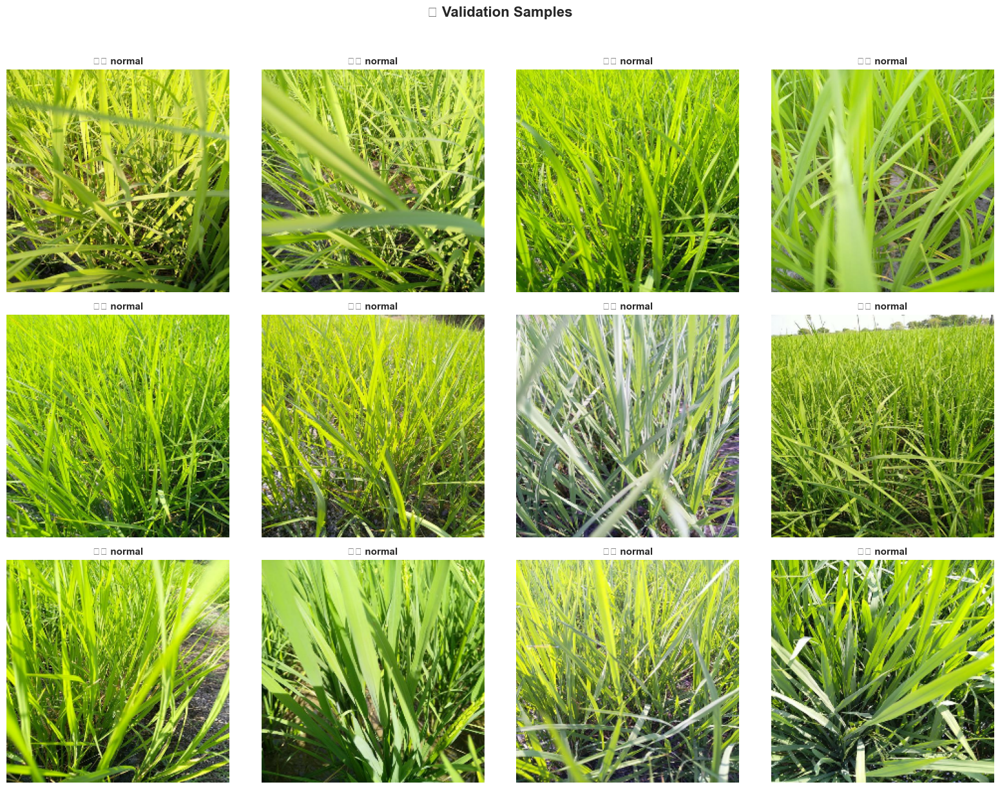

In [32]:
# ══════════════════════════════════════════════════════════════════════════════
# 🔄 SECTION 5.8: VISUALIZE AUGMENTED BATCH
# ══════════════════════════════════════════════════════════════════════════════

def visualize_batch(dataset, num_samples=12, title="Sample Batch"):
    """Visualize a batch of images from the dataset."""
    
    # Get one batch
    images, labels = next(iter(dataset))
    
    # Create figure
    num_rows = 3
    num_cols = 4
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(16, 12))
    
    for i in range(min(num_samples, len(images))):
        row = i // num_cols
        col = i % num_cols
        
        # Get image and label
        img = images[i].numpy()
        label_idx = np.argmax(labels[i])
        label_name = tf_class_names[label_idx]
        
        # Denormalize if needed
        if img.max() <= 1.0:
            img = (img * 255).astype(np.uint8)
        
        axes[row, col].imshow(img)
        axes[row, col].set_title(f'🏷️ {label_name}', fontsize=11, fontweight='bold')
        axes[row, col].axis('off')
    
    plt.suptitle(f'📸 {title}', fontsize=16, fontweight='bold', y=1.02)
    plt.tight_layout()
    plt.savefig(f'{title.lower().replace(" ", "_")}.png', dpi=300, bbox_inches='tight')
    plt.show()

# Visualize training batch (with augmentation)
print("📸 Visualizing Augmented Training Batch:")
visualize_batch(train_ds_processed, title="Augmented Training Samples")

# Visualize validation batch (without augmentation)
print("\n📸 Visualizing Validation Batch:")
visualize_batch(val_ds_processed, title="Validation Samples")

<a id="section-6"></a>

# 🧠 6. CNN Model Architecture Development
## 📖 Markdown Cell: Building the Classification Model
We'll use Transfer Learning with pre-trained models for optimal performance. Our strategy:

1. 🏗️ Use EfficientNetV2 as the backbone (state-of-the-art for image classification)
2. ❄️ Freeze base model layers initially
3. 🔝 Add custom classification head
4. 🔥 Fine-tune top layers after initial training
## 🏆 Why EfficientNetV2?
Accuracy: Achieves SOTA on ImageNet with fewer parameters
Efficiency: Faster training and inference
Scalability: Multiple variants (B0-B7, S, M, L, XL)

In [33]:
# ══════════════════════════════════════════════════════════════════════════════
# 🧠 SECTION 6.1: BUILD CUSTOM CNN FROM SCRATCH
# ══════════════════════════════════════════════════════════════════════════════

def build_custom_cnn(input_shape=config.INPUT_SHAPE, num_classes=config.NUM_CLASSES):
    """
    Build a custom CNN architecture from scratch.
    This is for educational purposes - transfer learning will perform better.
    """
    
    model = Sequential([
        # Input layer
        layers.InputLayer(input_shape=input_shape),
        
        # Block 1: Initial feature extraction
        layers.Conv2D(32, (3, 3), padding='same', activation='relu'),
        layers.BatchNormalization(),
        layers.Conv2D(32, (3, 3), padding='same', activation='relu'),
        layers.BatchNormalization(),
        layers.MaxPooling2D((2, 2)),
        layers.Dropout(0.25),
        
        # Block 2: Deeper features
        layers.Conv2D(64, (3, 3), padding='same', activation='relu'),
        layers.BatchNormalization(),
        layers.Conv2D(64, (3, 3), padding='same', activation='relu'),
        layers.BatchNormalization(),
        layers.MaxPooling2D((2, 2)),
        layers.Dropout(0.25),
        
        # Block 3: Higher-level features
        layers.Conv2D(128, (3, 3), padding='same', activation='relu'),
        layers.BatchNormalization(),
        layers.Conv2D(128, (3, 3), padding='same', activation='relu'),
        layers.BatchNormalization(),
        layers.MaxPooling2D((2, 2)),
        layers.Dropout(0.25),
        
        # Block 4: Complex features
        layers.Conv2D(256, (3, 3), padding='same', activation='relu'),
        layers.BatchNormalization(),
        layers.Conv2D(256, (3, 3), padding='same', activation='relu'),
        layers.BatchNormalization(),
        layers.MaxPooling2D((2, 2)),
        layers.Dropout(0.25),
        
        # Classification head
        layers.GlobalAveragePooling2D(),
        layers.Dense(512, activation='relu'),
        layers.BatchNormalization(),
        layers.Dropout(0.5),
        layers.Dense(256, activation='relu'),
        layers.BatchNormalization(),
        layers.Dropout(0.5),
        layers.Dense(num_classes, activation='softmax')
    ], name='custom_cnn')
    
    return model

# Build and display custom CNN
custom_cnn = build_custom_cnn()
print("🧠 CUSTOM CNN ARCHITECTURE")
print("=" * 70)
custom_cnn.summary()

🧠 CUSTOM CNN ARCHITECTURE


Model: "custom_cnn"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 224, 224, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 224, 224, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 224, 224, 32)   │         9,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 224, 224, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 112, 112, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 112, 112, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 112, 112, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 112, 112, 64)   │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 112, 112, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 112, 112, 64)   │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 56, 56, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 56, 56, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 56, 56, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_4           │ (None, 56, 56, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_5 (Conv2D)               │ (None, 56, 56, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_5           │ (None, 56, 56, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 28, 28, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 28, 28, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_6 (Conv2D)               │ (None, 28, 28, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_6           │ (None, 28, 28, 256)    │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_7 (Conv2D)               │ (None, 28, 28, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼─────────────

 Total params: 1,444,650 (5.51 MB)

 Trainable params: 1,441,194 (5.50 MB)

 Non-trainable params: 3,456 (13.50 KB)

In [34]:
# ══════════════════════════════════════════════════════════════════════════════
# 🧠 SECTION 6.2: BUILD TRANSFER LEARNING MODEL WITH EFFICIENTNETV2
# ══════════════════════════════════════════════════════════════════════════════

def build_efficientnet_model(input_shape=config.INPUT_SHAPE, 
                             num_classes=config.NUM_CLASSES,
                             trainable_base=False):
    """
    Build a transfer learning model using EfficientNetV2B3 as backbone.
    
    Parameters:
    -----------
    input_shape : tuple
        Shape of input images (height, width, channels)
    num_classes : int
        Number of output classes
    trainable_base : bool
        Whether to make base model trainable
    
    Returns:
    --------
    model : tf.keras.Model
        Compiled Keras model
    """
    
    # Load pre-trained EfficientNetV2B3
    base_model = EfficientNetV2B3(
        input_shape=input_shape,
        include_top=False,
        weights='imagenet',
        include_preprocessing=True  # Built-in preprocessing
    )
    
    # Freeze base model
    base_model.trainable = trainable_base
    
    # Build model architecture
    inputs = layers.Input(shape=input_shape, name='input_layer')
    
    # Data augmentation (optional - can use external augmentation instead)
    # x = data_augmentation(inputs)
    x = inputs
    
    # Base model
    x = base_model(x, training=False)
    
    # Custom classification head
    x = layers.GlobalAveragePooling2D(name='global_avg_pool')(x)
    x = layers.BatchNormalization(name='batch_norm_1')(x)
    x = layers.Dropout(0.5, name='dropout_1')(x)
    
    x = layers.Dense(512, activation='relu', name='dense_1')(x)
    x = layers.BatchNormalization(name='batch_norm_2')(x)
    x = layers.Dropout(0.3, name='dropout_2')(x)
    
    x = layers.Dense(256, activation='relu', name='dense_2')(x)
    x = layers.BatchNormalization(name='batch_norm_3')(x)
    x = layers.Dropout(0.2, name='dropout_3')(x)
    
    # Output layer
    outputs = layers.Dense(num_classes, activation='softmax', name='output_layer')(x)
    
    # Create model
    model = Model(inputs=inputs, outputs=outputs, name='efficientnet_paddy_classifier')
    
    return model, base_model

# Build the model
model, base_model = build_efficientnet_model()

print("🧠 EFFICIENTNETV2B3 TRANSFER LEARNING MODEL")
print("=" * 70)
print(f"\n📊 Base Model: EfficientNetV2B3")
print(f"   • Total layers: {len(base_model.layers)}")
print(f"   • Trainable: {base_model.trainable}")
print(f"\n📊 Full Model Statistics:")
print(f"   • Total parameters: {model.count_params():,}")
model.summary()

🧠 EFFICIENTNETV2B3 TRANSFER LEARNING MODEL

📊 Base Model: EfficientNetV2B3
   • Total layers: 409
   • Trainable: False

📊 Full Model Statistics:
   • Total parameters: 13,860,680


Model: "efficientnet_paddy_classifier"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ efficientnetv2-b3 (Functional)  │ (None, 7, 7, 1536)     │    12,930,622 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_avg_pool                 │ (None, 1536)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_norm_1                    │ (None, 1536)           │         6,144 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 1536)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 512)            │       786,944 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_norm_2                    │ (None, 512)            │         2,048 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 512)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 256)            │       131,328 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_norm_3                    │ (None, 256)            │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_3 (Dropout)             │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output_layer (Dense)            │ (None, 10)             │         2,570 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 13,860,680 (52.87 MB)

 Trainable params: 925,450 (3.53 MB)

 Non-trainable params: 12,935,230 (49.34 MB)

In [ ]:
# ══════════════════════════════════════════════════════════════════════════════
# 🧠 SECTION 6.4: COMPILE THE MODEL
# ══════════════════════════════════════════════════════════════════════════════

# Calculate class weights for imbalanced data
from sklearn.utils.class_weight import compute_class_weight

# Get class weights
class_weights_array = compute_class_weight(
    class_weight='balanced',
    classes=np.unique(train_data['label']),
    y=train_data['label']
)

class_weights = dict(zip(range(len(class_weights_array)), class_weights_array))

print("⚖️ CLASS WEIGHTS (for handling class imbalance):")
print("=" * 70)
for idx, weight in class_weights.items():
    class_name = class_labels.get(idx, f"Class_{idx}")
    print(f"   {class_name:30s}: {weight:.4f}")

# Compile model
model.compile(
    optimizer=Adam(learning_rate=config.LEARNING_RATE),
    loss=CategoricalCrossentropy(label_smoothing=0.1),  # Label smoothing helps generalization
    metrics=[
        'accuracy',
        tf.keras.metrics.Precision(name='precision'),
        tf.keras.metrics.Recall(name='recall'),
        tf.keras.metrics.AUC(name='auc')
    ]
)

print("\n✅ Model compiled successfully!")
   